In [1]:
%load_ext autoreload
%autoreload 2

# 🧠 TissueTag Annotation Tutorial: Visium HD H&E Image of Mouse Brain

Welcome!  
In this tutorial, we’ll walk through the process of annotating a **Visium HD H&E image** from a **fresh-frozen mouse brain sample**. This notebook will guide you from raw data download to generating high-quality tissue annotations using both automated and manual approaches.

## 📦 Download the Sample Data

We'll use the publicly available dataset from 10x Genomics.  
Run the following commands in your terminal to download all necessary files and set up the demo directory

<small>

```bash
mkdir ../data/tissue_tag_example_visiumHD
chdir ../data/tissue_tag_example_visiumHD
curl -O https://cf.10xgenomics.com/samples/spatial-exp/3.1.1/Visium_HD_Mouse_Brain_Fresh_Frozen/Visium_HD_Mouse_Brain_Fresh_Frozen_web_summary.html
curl -O https://cf.10xgenomics.com/samples/spatial-exp/3.1.1/Visium_HD_Mouse_Brain_Fresh_Frozen/Visium_HD_Mouse_Brain_Fresh_Frozen_cloupe_008um.cloupe
curl -O https://cf.10xgenomics.com/samples/spatial-exp/3.1.1/Visium_HD_Mouse_Brain_Fresh_Frozen/Visium_HD_Mouse_Brain_Fresh_Frozen_feature_slice.h5
curl -O https://cf.10xgenomics.com/samples/spatial-exp/3.1.1/Visium_HD_Mouse_Brain_Fresh_Frozen/Visium_HD_Mouse_Brain_Fresh_Frozen_metrics_summary.csv
curl -O https://cf.10xgenomics.com/samples/spatial-exp/3.1.1/Visium_HD_Mouse_Brain_Fresh_Frozen/Visium_HD_Mouse_Brain_Fresh_Frozen_molecule_info.h5
curl -O https://cf.10xgenomics.com/samples/spatial-exp/3.1.1/Visium_HD_Mouse_Brain_Fresh_Frozen/Visium_HD_Mouse_Brain_Fresh_Frozen_spatial.tar.gz
curl -O https://cf.10xgenomics.com/samples/spatial-exp/3.1.1/Visium_HD_Mouse_Brain_Fresh_Frozen/Visium_HD_Mouse_Brain_Fresh_Frozen_binned_outputs.tar.gz
curl -O https://cf.10xgenomics.com/samples/spatial-exp/3.1.1/Visium_HD_Mouse_Brain_Fresh_Frozen/Visium_HD_Mouse_Brain_Fresh_Frozen_tissue_image.tif

tar -xvzf Visium_HD_Mouse_Brain_Fresh_Frozen_spatial.tar.gz
tar -xvzf Visium_HD_Mouse_Brain_Fresh_Frozen_binned_outputs.tar.gz
``` 
</small>


## 🧭 Annotation Strategy

We’ll explore several annotation strategies, ranging from automated predictions to manual refinement:

1. **Fully Automatic** – Quickly capture broad tissue features (e.g., tissue boundaries, white and gray matter) using a simple pixel classifier.  
2. **Semi-Automatic** – Gene-guided labeling combined with manual annotation and drawing for finer control.

All annotations will be saved as a `TissueTag` annotation class object in an `.h5` file.


---

Let's get started! 🚀


bioimageio_utils.py (2): pkg_resources is deprecated as an API. See https://setuptools.pypa.io/en/latest/pkg_resources.html. The pkg_resources package is slated for removal as early as 2025-11-30. Refrain from using this package or pin to Setuptools<81.


<img src='data:image/png;base64,iVBORw0KGgoAAAANSUhEUgAAAEAAAABACAYAAACqaXHeAAAABHNCSVQICAgIfAhkiAAAAAlwSFlz
AAAB+wAAAfsBxc2miwAAABl0RVh0U29mdHdhcmUAd3d3Lmlua3NjYXBlLm9yZ5vuPBoAAA6zSURB
VHic7ZtpeFRVmsf/5966taWqUlUJ2UioBBJiIBAwCZtog9IOgjqACsogKtqirT2ttt069nQ/zDzt
tI4+CrJIREFaFgWhBXpUNhHZQoKBkIUASchWla1S+3ar7r1nPkDaCAnZKoQP/D7mnPOe9/xy76n3
nFSAW9ziFoPFNED2LLK5wcyBDObkb8ZkxuaoSYlI6ZcOKq1eWFdedqNzGHQBk9RMEwFAASkk0Xw3
ETacDNi2vtvc7L0ROdw0AjoSotQVkKSvHQz/wRO1lScGModBFbDMaNRN1A4tUBCS3lk7BWhQkgpD
lG4852/+7DWr1R3uHAZVQDsbh6ZPN7CyxUrCzJMRouusj0ipRwD2uKm0Zn5d2dFwzX1TCGhnmdGo
G62Nna+isiUqhkzuKrkQaJlPEv5mFl2fvGg2t/VnzkEV8F5ioioOEWkLG86fvbpthynjdhXYZziQ
x1hC9J2NFyi8vCTt91Fh04KGip0AaG9zuCk2wQCVyoNU3Hjezee9bq92duzzTmxsRJoy+jEZZZYo
GTKJ6SJngdJqAfRzpze0+jHreUtPc7gpBLQnIYK6BYp/uGhw9YK688eu7v95ysgshcg9qSLMo3JC
4jqLKQFBgdKDPoQ+Pltb8dUyQLpeDjeVgI6EgLIQFT5tEl3rn2losHVsexbZ3EyT9wE1uGdkIPcy
BGxn8QUq1QrA5nqW5i2tLqvrrM9NK6AdkVIvL9E9bZL/oyfMVd/jqvc8LylzRBKDJSzIExwhQzuL
QYGQj4rHfFTc8mUdu3E7yoLtbTe9gI4EqVgVkug2i5+uXGo919ixbRog+3fTbQ8qJe4ZOYNfMoTI
OoshUNosgO60AisX15aeI2PSIp5KiFLI9ubb1vV3Qb2ltwLakUCDAkWX7/nHKRmmGIl9VgYsUhJm
2NXjKYADtM1ygne9QQDIXlk49FBstMKx66D1v4+XuQr7vqTe0VcBHQlRWiOCbmmSYe2SqtL6q5rJ
zsTb7lKx3FKOYC4DoqyS/B5bvLPxvD9Qtf6saxYLQGJErmDOdOMr/zo96km1nElr8bmPOBwI9COv
HnFPRIwmkSOv9kcAS4heRsidOkpeWBgZM+UBrTFAXNYL5Vf2ii9c1trNzpYdaoVil3WIc+wdk+gQ
noie3ecCcxt9ITcLAPWt/laGEO/9U6PmzZkenTtsSMQ8uYywJVW+grCstAvCIaAdArAsIWkRDDs/
KzLm2YcjY1Lv0UdW73HabE9n6V66cxSzfEmuJssTpKGVp+0vHq73FwL46eOjpMpbRAnNmJFrGJNu
Ukf9Yrz+3rghiumCKNXXWPhLYcjxGsIpoCMsIRoFITkW8AuyM8jC1+/QLx4bozCEJIq38+1rtpR6
V/yzb8eBlRb3fo5l783N0CWolAzJHaVNzkrTzlEp2bQ2q3TC5gn6wpnoQAmwSiGh2GitnTmVMc5O
UyfKWUKCIsU7+fZDKwqdT6DDpvkzAX4/+AMFjk0tDp5GRXLpQ2MUmhgDp5gxQT8+Y7hyPsMi8uxF
71H0oebujHALECjFKaW9Lm68n18wXp2kVzIcABytD5iXFzg+WVXkegpAsOOYziqo0OkK76GyquC3
ltZAzMhhqlSNmmWTE5T6e3IN05ITFLM4GdN0vtZ3ob8Jh1NAKXFbm5PtLU/eqTSlGjkNAJjdgn/N
aedXa0tdi7+t9G0FIF49rtMSEgAs1kDLkTPO7ebm4IUWeyh1bKomXqlgMG6kJmHcSM0clYLJ8XtR
1GTnbV3F6I5wCGikAb402npp1h1s7LQUZZSMIfALFOuL3UUrfnS8+rez7v9qcold5tilgHbO1fjK
9ubb17u9oshxzMiUBKXWqJNxd+fqb0tLVs4lILFnK71H0Ind7uiPgACVcFJlrb0tV6DzxqqTIhUM
CwDf1/rrVhTa33/3pGPxJYdQ2l2cbgVcQSosdx8uqnDtbGjh9SlDVSMNWhlnilfqZk42Th2ZpLpf
xrHec5e815zrr0dfBZSwzkZfqsv+1FS1KUknUwPARVvItfKUY+cn57yP7qv07UE3p8B2uhUwLk09
e0SCOrK+hbdYHYLjRIl71wWzv9jpEoeOHhGRrJAzyEyNiJuUqX0g2sBN5kGK6y2Blp5M3lsB9Qh4
y2Ja6x6+i0ucmKgwMATwhSjdUu49tKrQ/pvN5d53ml2CGwCmJipmKjgmyuaXzNeL2a0AkQ01Th5j
2DktO3Jyk8f9vcOBQHV94OK+fPumJmvQHxJoWkaKWq9Vs+yUsbq0zGT1I4RgeH2b5wef7+c7bl8F
eKgoHVVZa8ZPEORzR6sT1BzDUAD/d9F78e2Tzv99v8D+fLVTqAKAsbGamKey1Mt9Ann4eH3gTXTz
idWtAJ8PQWOk7NzSeQn/OTHDuEikVF1R4z8BQCy+6D1aWRfY0tTGG2OM8rRoPaeIj5ZHzJxszElN
VM8K8JS5WOfv8mzRnQAKoEhmt8gyPM4lU9SmBK1MCQBnW4KONT86v1hZ1PbwSXPw4JWussVjtH9Y
NCoiL9UoH/6PSu8jFrfY2t36erQHXLIEakMi1SydmzB31h3GGXFDFNPaK8Rme9B79Ixrd0WN+1ij
NRQ/doRmuFLBkHSTOm5GruG+pFjFdAmorG4IXH1Qua6ASniclfFtDYt+oUjKipPrCQB7QBQ2lrgP
fFzm+9XWUtcqJ3/5vDLDpJ79XHZk3u8nGZ42qlj1+ydtbxysCezrydp6ugmipNJ7WBPB5tydY0jP
HaVNzs3QzeE4ZpTbI+ZbnSFPbVOw9vsfnVvqWnirPyCNGD08IlqtYkh2hjZ5dErEQzoNm+6ykyOt
Lt5/PQEuSRRKo22VkydK+vvS1XEKlhCJAnsqvcVvH7f/ZU2R67eXbMEGAMiIV5oWZWiWvz5Fv2xG
sjqNJQRvn3Rs2lji/lNP19VjAQDgD7FHhujZB9OGqYxRkZxixgRDVlqS6uEOFaJUVu0rPFzctrnF
JqijImVp8dEKVWyUXDk92zAuMZ6bFwpBU1HrOw6AdhQgUooChb0+ItMbWJitSo5Ws3IAOGEOtL53
0vHZih9sC4vtofZ7Qu6523V/fmGcds1TY3V36pUsBwAbSlxnVh2xLfAD/IAIMDf7XYIkNmXfpp2l
18rkAJAy9HKFaIr/qULkeQQKy9zf1JgDB2uaeFNGijo5QsUyacNUUTOnGO42xSnv4oOwpDi1zYkc
efUc3I5Gk6PhyTuVKaOGyLUAYPGIoY9Pu/atL/L92+4q9wbflRJ2Trpm/jPjdBtfnqB/dIThcl8A
KG7hbRuKnb8qsQsVvVlTrwQAQMUlf3kwJI24Z4JhPMtcfng5GcH49GsrxJpGvvHIaeem2ma+KSjQ
lIwUdYyCY8j4dE1KzijNnIP2llF2wcXNnsoapw9XxsgYAl6k+KzUXbi2yP3KR2ecf6z3BFsBICdW
nvnIaG3eHybqX7vbpEqUMT+9OL4Qpe8VON7dXuFd39v19FoAABRVePbGGuXTszO0P7tu6lghUonE
llRdrhArLvmKdh9u29jcFiRRkfLUxBiFNiqSU9icoZQHo5mYBI1MBgBH6wMNb+U7Pnw337H4gi1Y
ciWs+uks3Z9fztUvfzxTm9Ne8XXkvQLHNytOOZeiD4e0PgkAIAYCYknKUNUDSXEKzdWNpnil7r4p
xqkjTarZMtk/K8TQ6Qve78qqvXurGwIJqcOUKfUWHsm8KGvxSP68YudXq4pcj39X49uOK2X142O0
Tz5/u/7TVybqH0rSya6ZBwD21/gubbrgWdDgEOx9W
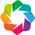

In [2]:

# initialisation 
import os
import panel as pn
import bin2cell as b2c
import tissue_tag as tt
import tissue_tag.annotation
import tissue_tag.io
from tissue_tag.io import TissueTagAnnotation
os.environ["BOKEH_ALLOW_WS_ORIGIN"] = "*"
# host = <port> # set the port to the value in the address bar when operating in farm
host = '8888' # when working locally e.g. desktop

# 🚀 Initiate

We will start by:

- Reading in the image data  
- Defining the resolution we’ll work with  
- Loading the associated `AnnData` object  

> ⚠️ **Note:** `TissueTag` is designed for **tissue-level** annotations. We do **not** recommend using it for annotating very small structures, such as single cells.  
> For best performance and clarity, we recommend working at a resolution of **0.5 pixels per micron (ppm)** — equivalent to **2 microns per pixel**.


In [4]:
# set paths
# Here we will use the 16um binned data that is available from 10X for the annotation, don't worry, later you can map these annotations to any other resolution (2um, 8um and even a single cell Bin2Cell object - https://github.com/Teichlab/bin2cell )
spaceranger_dir_path = "/Users/ny296/Documents/tissue_tag_example_visiumHD"
mapped_image_path = spaceranger_dir_path + '/Visium_HD_Mouse_Brain_Fresh_Frozen_tissue_image.tif' # the image that was used for spaceranger input
spaceranger_spatial_path = spaceranger_dir_path +'/spatial' # path to the spatial folder for this dataset (this structure was changed a few times) 
bin_resolution = 16 # bin resolution to work with

tt_obj = tissue_tag.io.read_visium_hd(
    spaceranger_dir_path=spaceranger_dir_path, 
    mapped_image_path=mapped_image_path,
    use_resolution='mapped_res', # use the max resolution 
    ppm_out=0.5,
    plot=True,
    bin_resolution=bin_resolution)

!!! Make sure this mapped_res image is the same one you used as spaceranger input !!!


FileNotFoundError: [Errno 2] No such file or directory: '/Users/ny296/Documents/tissue_tag_example_visiumHD/Visium_HD_Mouse_Brain_Fresh_Frozen_tissue_image.tif'

# Automatic annotations - Create de-novo annotations from gene expression (or not)

In [5]:
# read anndata with bin2cell make sure you are using the same binning resolution!!
adata = b2c.read_visium(
    path = spaceranger_dir_path + f'/binned_outputs/square_0{bin_resolution}um/',
    spaceranger_image_path = spaceranger_spatial_path
)

anndata.py (1758): Variable names are not unique. To make them unique, call `.var_names_make_unique`.
anndata.py (1758): Variable names are not unique. To make them unique, call `.var_names_make_unique`.


In [6]:
# Define anatomical structure annotations
# and their associated color codes.
#
# Color families:
#   • Red:         'red', 'darkred', 'firebrick', 'indianred'
#   • Green:       'green', 'darkgreen', 'lime', 'seagreen', 'forestgreen'
#   • Blue:        'blue', 'darkblue', 'royalblue', 'dodgerblue', 'deepskyblue'
#   • Cyan:        'cyan', 'lightcyan', 'darkcyan', 'teal'
#   • Magenta:     'magenta', 'purple', 'darkmagenta', 'orchid', 'violet'
#   • Yellow/Orange:'gold', 'orange', 'darkorange', 'goldenrod'
#   • Brown:       'brown', 'saddlebrown', 'chocolate', 'peru', 'tan'
#   • Gray/Black:  'black', 'gray', 'darkgray', 'dimgray', 'lightgray'
#   • White:       'white'

tt_obj.annotation_map = {
    'unassigned':      'yellow',
    'isocortex':       'green',
    'hippocampus':     'darkgreen',
    'olfactory':       'orange',
    'striatum':        'red',
    'thalamus':        'blue',
    'amygdala':        'lime',
    'choroid_plexus':  'gold',
    'pia':             'deepskyblue',
    'white_matter':    'white',
    'gray_matter':     'teal',
    'dentate_gyrus':   'violet',
    'layer_1':         'tan',

}
# note if you need to add annotation to an exxisting object add them in the end and do not change the order as this corresponds to the pixel values of the label image. e.g. unassigned = 1, isocortex=2 etc

(3153, 4500, 4)


_normalization.py (208): Received a view of an AnnData. Making a copy.
anndata.py (1758): Variable names are not unique. To make them unique, call `.var_names_make_unique`.


🧬 Processing marker: 'gray_matter' | Color: teal | Genes: ['Gad1', 'Gad2', 'Slc17a7']
🧬 Processing marker: 'white_matter' | Color: white | Genes: ['Mbp', 'Gfap']


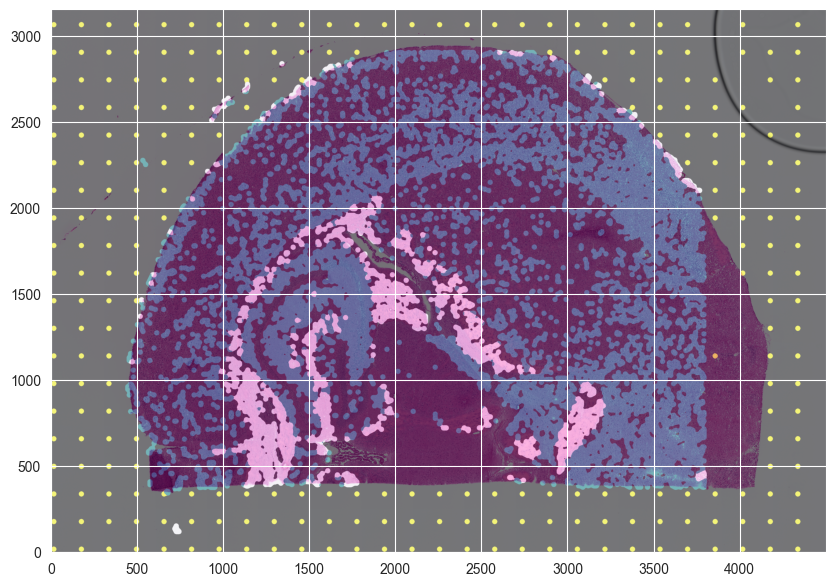

In [7]:

# Define gene markers per region
# Format: region_name: List of (gene, expression threshold)

gene_markers = {
    'gray_matter': [
        ('Gad1', 2500),
        ('Gad2', 2500),
        ('Slc17a7', 3000)
    ],
    'white_matter': [
        ('Mbp', 1500),
        ('Gfap',500)
    ]
}

# Generate training labels from gene expression
# This maps regions based on marker expression

tissue_tag.annotation.gene_labels_from_adata(
    adata=adata,
    gene_markers=gene_markers,
    tissue_tag_annotation=tt_obj,
    diameter=bin_resolution * 4,  # Labeling diameter
    override_labels=True,         # Replace any existing labels
    normalize=True               # Use raw expression
)


# Visualize the assigned labels
tissue_tag.annotation.median_filter(tt_obj,filter_radius=bin_resolution)
tissue_tag.annotation.plot_labels(tt_obj, alpha=0.5) # i wasn't able to supress putput in annotation.plot_labels



### 🧠 Pixel Classification

In this step, we train a **Random Forest pixel classifier** using the labeled regions provided earlier.  
This model will then be used to predict annotations for all image pixels.

⏱️ **Estimated runtime:** 1–10 minutes, depending on image resolution, sysyem performance and the number of training areas.

The result will be stored in the existing `TissueTag` object.


[INFO] Initializing classifier...
[INFO] Extracting features from all RGB channels...
[INFO] Training Random Forest classifier on RGB features...
[INFO] Predicting labels based on trained classifier...
[INFO] Final label prediction completed.
[INFO] Generating visualization...
[INFO] Visualization complete.
[INFO] Classification finished successfully.
CPU times: user 1min 49s, sys: 10.3 s, total: 1min 59s
Wall time: 21.7 s


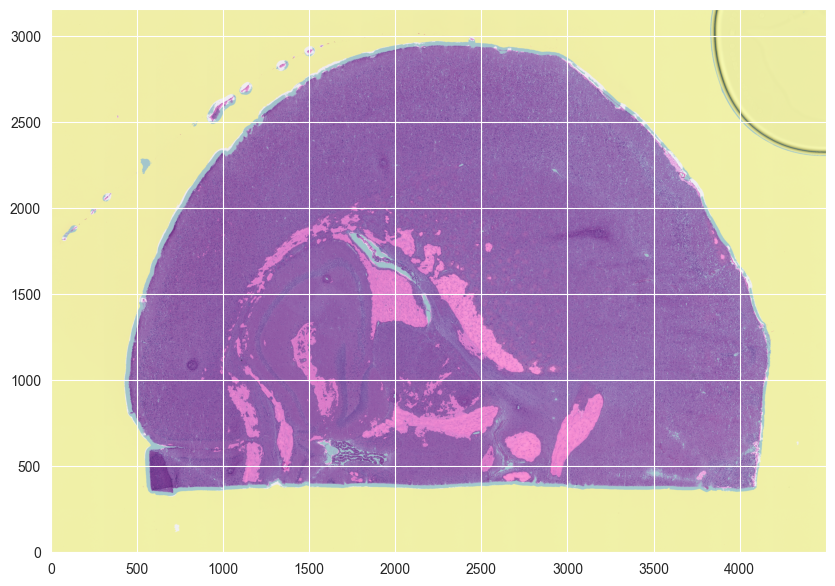

In [8]:
%%time
tissue_tag.annotation.sk_rf_classifier(tt_obj)

# 🧬 Gene-Guided Labeling

In this step, we overlay **gene expression–based labels** on top of the previous classification.  
These labels serve as additional guidance for **manual tissue annotation**, helping refine regional identity using known gene markers.

We define a dictionary of **marker genes** and their expression thresholds for key brain regions.  
From this, we generate spatial labels directly from the `AnnData` object and add them to the existing `TissueTag` annotation.

> 🔍 These gene-based labels are not final annotations—they are **hints** to support accurate manual refinement.


Label image is not empty.
Will add new gene labels on top of old label_image.
(3153, 4500, 4)
🧬 Processing marker: 'isocortex' | Color: green | Genes: ['Pak7', 'Myl4', 'Ttc9b']
🧬 Processing marker: 'amygdala' | Color: lime | Genes: ['Acvr2a']
🧬 Processing marker: 'olfactory' | Color: orange | Genes: ['Cdhr1']
🧬 Processing marker: 'striatum' | Color: red | Genes: ['Adora2a', 'Gprin3']
🧬 Processing marker: 'thalamus' | Color: blue | Genes: ['Plekhg1']
🧬 Processing marker: 'choroid_plexus' | Color: gold | Genes: ['Tcf21']
🧬 Processing marker: 'hippocampus' | Color: darkgreen | Genes: ['Zbtb20']


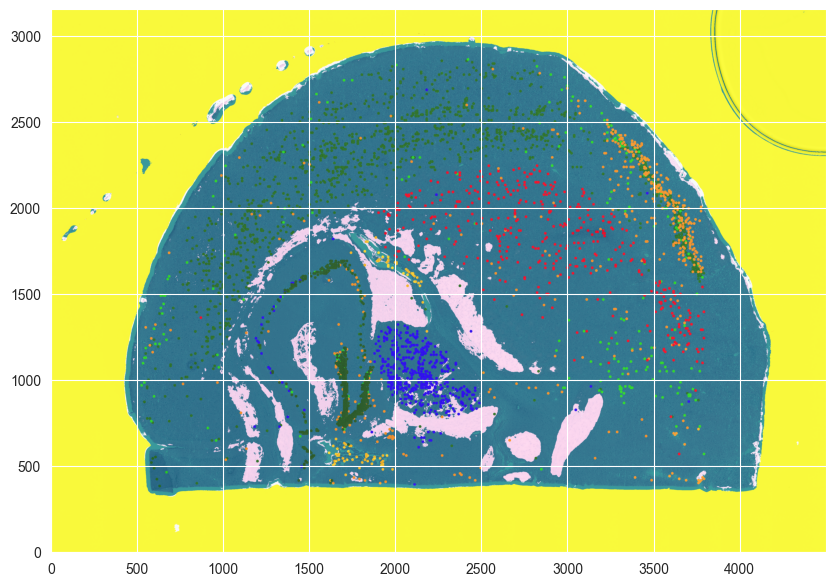

In [9]:
# select gene markers 
gene_markers = {
    'isocortex': [('Pak7',500),('Myl4',500),('Ttc9b',500)],
    'amygdala':[('Acvr2a',300)],
    'olfactory': [('Cdhr1',500)],
    'striatum': [('Adora2a',200),('Gprin3',200)],
    'thalamus': [('Plekhg1',500)],
	'choroid_plexus':[('Tcf21',500)],
    'hippocampus': [('Zbtb20',500)],
}

# generate training data from gene expression
tissue_tag.annotation.gene_labels_from_adata(
    adata = adata,
    gene_markers = gene_markers,    
    tissue_tag_annotation=tt_obj,
    diameter = bin_resolution*2,
    normalize=False,

) # generate gene-marker-labels
tissue_tag.annotation.plot_labels(tt_obj, alpha=0.25)

### ✍️ Interactive Tissue Annotator

Now it's time to manually refine the tissue annotation using the **interactive annotator**, powered by **Panel** and **Datashader**.

This tool gives you full control over the labeling process with an intuitive interface:

1. 🖼️ **Image Toggle**  
   Use the slider to toggle between the raw image and the current annotation labels for visual comparison.

2. 🎨 **Structure Selector**  
   On the left, you'll see each tissue structure represented by its **first letter** in color.  
   Hover over a letter to reveal the **full region name**.

3. 🖋️ **Drawing Annotations**  
   Select a tissue structure and **draw freely** over the region of interest.  
   Then, click the **Update** button to "fill" the sketched shapes into annotations.  
   *(Shapes do not need to be closed manually—this is handled for you.)*

4. 🗑️ **Removing Annotations**  
   - If you haven’t pressed **Update** yet, simply click the drawn line and hit `Backspace`.  
   - If you've already updated, you can click **Revert** to undo the last annotation fill.

---

> ⚙️ **Rendering Option: `use_datashader=True`**  
> At this stage, you can choose whether to render the image using **Datashader**.  
> Setting `use_datashader=True` is **recommended for large images or high-resolution annotations**.  
> While annotation drawing is slightly slower with Datashader, it ensures smooth and responsive image loading.  
> Without Datashader, very large images might fail to load or take a very long time to render.

---

> ⚠️ **Tip:** For the best experience, we **highly recommend using a mouse with a scroll wheel**. Trackpads or touchscreen input may behave inconsistently.

All annotations are automatically assigned to your `TissueTag` annotation object and can be saved later as part of the `.h5` file.


In [64]:
# use annotator to label tissue regions according to categories indicated above
annotator = tissue_tag.annotation.annotator(tt_obj, use_datashader=True)
pn.io.notebook.show_server(annotator, notebook_url=f'localhost:'+host)

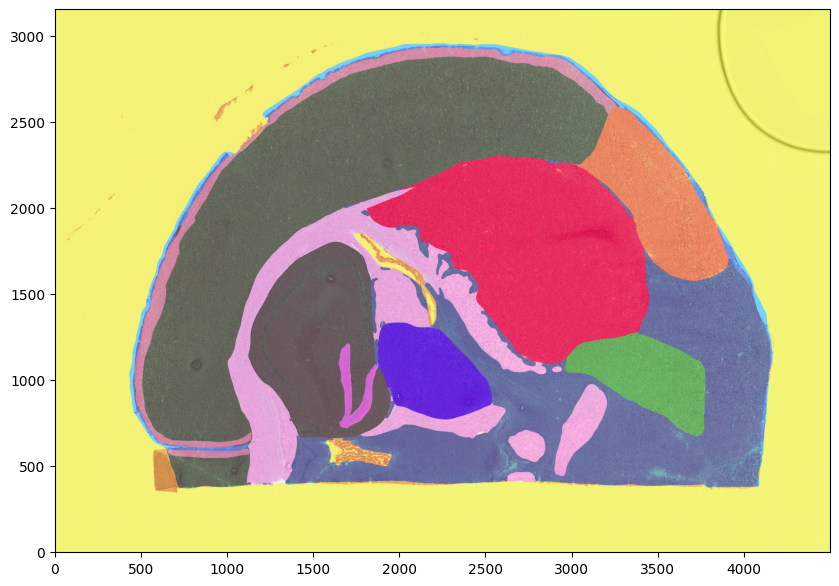

In [65]:
tissue_tag.annotation.plot_labels(tt_obj, alpha=0.5)

# 💾 Save Annotation Output

After completing the annotation process, we save the results for future use.  
This includes the labeled image, annotation map, and any interactive edits made during the session.

Annotations will be saved as an `.h5` file inside the `tt_annotations` folder, within the binned output directory:

- The output path is based on the current bin resolution (e.g., `square_16um` for 16μm bins).
- If the target directory does not exist, it will be created automatically.

This allows seamless integration with downstream analysis or loading annotations in a future session using `TissueTag`.


In [69]:
path = spaceranger_dir_path + f'/binned_outputs/square_0{bin_resolution}um/'
isExist = os.path.exists(path+'tt_annotations')
if not(isExist):
    os.mkdir(path+'/tt_annotations/')
    
tt_obj.save_annotation(file_path=path+'/tt_annotations/annotations_v1.h5')

> loaded image - size - (3153, 4500, 4)
> loaded ppm: 0.5
> loaded label image - size - (3153, 4500)
> loaded annotation map:
{'unassigned': 'yellow', 'isocortex': 'green', 'hippocampus': 'darkgreen', 'olfactory': 'orange', 'striatum': 'red', 'thalamus': 'blue', 'amygdala': 'lime', 'choroid_plexus': 'gold', 'pia': 'deepskyblue', 'white_matter': 'white', 'gray_matter': 'teal', 'dentate_gyrus': 'violet', 'layer_1': 'tan'}
> loaded positions


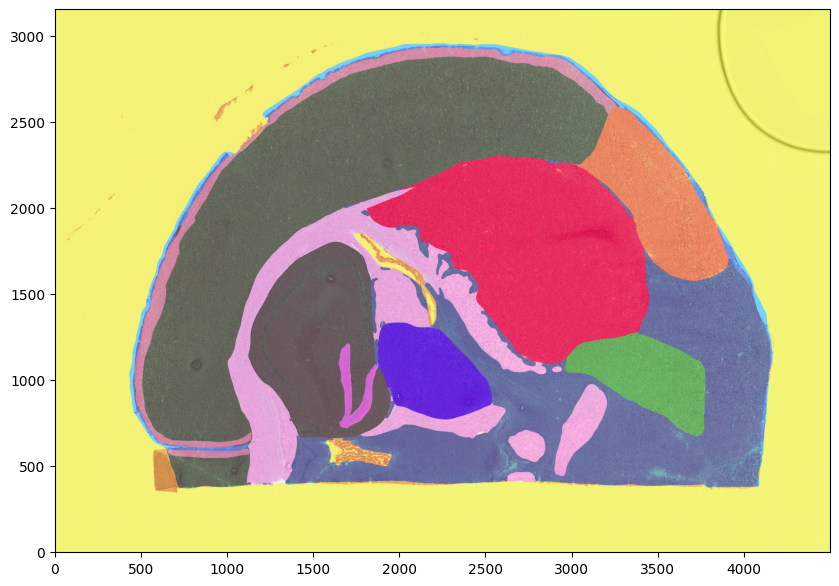

In [70]:
# we recommend loading the object to make sure it's all saved properly 
tt_obj = tt.load_annotation(file_path=path+'/tt_annotations/annotations_v1.h5')
im = tissue_tag.annotation.plot_labels(tt_obj, alpha=0.5)

# 📐 Calculate Spatial Distances to Annotations

In this step, we generate a **regular spatial grid** across the annotated image and compute the **mean distance from each grid point to nearby annotated tissue structures**.

This allows us to:

- Consistently quantify spatial proximity to anatomical regions
- Create interpretable spatial axes (e.g. cortical gradients, medial-lateral transitions)

#### 🧭 How it works:

1. **Grid Generation**  
   A tight hexagonal grid is generated across the tissue using `grid_unit_size` spacing (in microns).  
   Each grid point is assigned a label based on the median annotation value "under" each grid spot.

2. **Neighborhood Distance Calculation**  
   Using a fast KD-tree implementation, the grid is queried against each annotated region.  
   For each annotated structure, we calculate the **mean distance** to its `k` nearest neighbors (`nhood_size`), for every grid point.

---

> ⚙️ **Parameters Used**  
> - `grid_unit_size = 15`: spacing between grid points, in microns  
> - `nhood_size = 10`: number of nearest neighbors used for computing distances  

---

The output is stored in `tt_obj.grid`, containing:

- Coordinates (`x`, `y`)
- Region labels and numeric codes
- Per-category distance columns (e.g. `L2_dist_annotation_hippocampus`)

You can use this grid for further downstream tasks such as:

- Visualizing spatial trends
- Transferring annotations to data (`map_annotations_to_target`) e.g. 16/8/2um/Bin2Cell object from the same visium HD dataset
- Creating spatial axes (with `calculate_axis_2p/3p`)
- Binning space into anatomical domains (`bin_axis`)



In [ ]:
# tt_obj = tt.load_annotation(file_path=path+'/tt_annotations/annotations.h5')
grid_unit_size = 15
nhood_size = 10

########## this part should be merged into a future function tt_obj.grid = calculate_distances_to_nhood(tt_obj,grid_unit_size,nhood_size)
tt_obj.grid = tt.generate_grid_from_annotation(tt_obj, spot_to_spot = grid_unit_size)
print('calculating distances')
tt.calculate_distance_to_annotations(
    tt_obj.grid,
    knn=nhood_size
    ) # calculate minimum mean distance of each spot to clusters
tt_obj.grid['annotation'].value_counts()

##########


Generating grid with spacing - 15, from annotation resolution of - 0.5 ppm
calculating distances
calculating distance matrix with cKDTree
amygdala
choroid_plexus
dentate_gyrus
gray_matter
hippocampus
isocortex
layer_1
olfactory
pia
striatum
thalamus
unassigned
white_matter
{'amygdala': array([6094.52158168, 6089.27323134, 6084.05745706, ..., 4197.06052767,
       4210.68505767, 4224.31894589]), 'choroid_plexus': array([3397.7947072 , 3393.26886702, 3388.80337617, ..., 5614.70958942,
       5622.91860811, 5631.15561465]), 'dentate_gyrus': array([3616.27364121, 3610.25833603, 3604.29541693, ..., 6655.73306565,
       6665.00618657, 6674.30013508]), 'gray_matter': array([2483.47189475, 2478.82222571, 2474.25482216, ..., 2591.37157241,
       2603.96089315, 2616.57563481]), 'hippocampus': array([3103.57721673, 3093.91287854, 3084.26934815, ..., 6099.7169658 ,
       6106.78408393, 6113.87983307]), 'isocortex': array([1615.51867809, 1608.37934278, 1601.34864756, ..., 2817.9565839 ,
       2

annotation
unassigned        131486
isocortex          43189
gray_matter        31463
striatum           24060
white_matter       15852
hippocampus        12788
olfactory           8481
amygdala            5621
thalamus            5387
layer_1             5155
pia                 3814
choroid_plexus       940
dentate_gyrus        874
Name: count, dtype: int64

### 🔄 Map Grid Annotations to Visium HD 16μm Spots

Now that we’ve generated the annotated spatial grid, we map these annotations back to the original **Visium HD 16μm object** to enable downstream integration with gene expression data.

#### 🧭 Step Overview:

1. **Extract Spot Coordinates**  
   We directly convert `adata.obsm['spatial']` into a DataFrame with `"x"` and `"y"` columns, using the spot barcodes from `adata.obs_names` as the index.

2. **Calculate Pixels-Per-Micron (ppm)**  
   The spatial scaling is retrieved from `adata.uns['spatial']`, and the pixels-per-micron (`ppm_target`) is computed as the inverse of `"microns_per_pixel"`.

3. **Map Annotations**  
   We use `tt.map_annotations_to_target()` to assign annotations from the grid to Visium spots using a **KD-tree nearest-neighbor search**.  
   The `max_distance` parameter ensures that only nearby annotations (within 2× spot size) are transferred.

4. **Alignment Preview**  
   A scatter plot is automatically generated to visually compare the source grid and target Visium spot positions, ensuring spatial alignment.

5. **Map to AnnData obs**  
   matching back indices and transfer annotations to object 

---

> 🧪 This step is essential to bridge spatial gene expression data with your refined anatomical annotation grid.

> 📌 `ppm_source` is set to 1 (since the grid is already in pixel space), while_



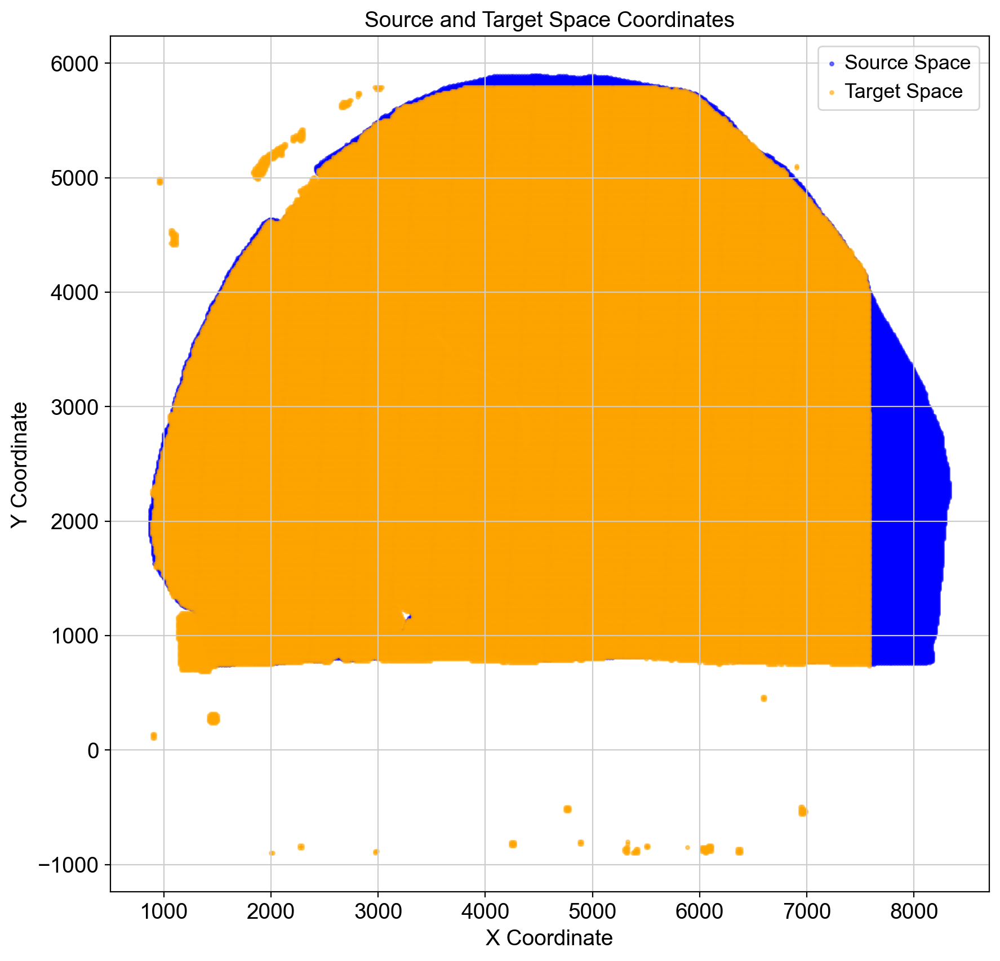

,in_tissue,array_row,array_col,L2_dist_annotation_amygdala,L2_dist_annotation_choroid_plexus,L2_dist_annotation_dentate_gyrus,L2_dist_annotation_gray_matter,L2_dist_annotation_hippocampus,L2_dist_annotation_isocortex,L2_dist_annotation_layer_1,L2_dist_annotation_olfactory,L2_dist_annotation_pia,L2_dist_annotation_striatum,L2_dist_annotation_thalamus,L2_dist_annotation_unassigned,L2_dist_annotation_white_matter,annotation,annotation_number
s_016um_00107_00066-1,1,107,66,922.490575,2653.695264,2992.013760,16.794229,2783.946217,3712.339228,4280.404170,1488.839374,1634.465948,1542.764285,1728.869059,57.862352,579.401754,gray_matter,11.0
s_016um_00126_00213-1,1,126,213,1942.957433,289.375715,739.022272,16.794229,546.380400,1910.121800,1915.104834,1163.879729,1953.886689,1700.246432,485.533303,321.896542,339.433702,gray_matter,11.0
s_016um_00158_00414-1,1,158,414,4786.917633,2297.104977,2364.855150,1640.990791,1435.121717,83.318180,43.675140,3410.659701,16.794229,3528.627335,2847.338383,58.074527,1153.144942,pia,9.0
s_016um_00242_00130-1,1,242,130,822.939791,1219.449797,1946.506605,507.102391,1824.733127,1598.142841,2329.072709,1453.798474,2292.353123,16.794229,1012.521354,1086.813106,551.347371,striatum,5.0
s_016um_00230_00364-1,1,230,364,4010.722051,2012.978791,1636.994838,1738.211004,565.389079,16.794229,504.217156,3104.387725,658.139766,2218.323848,2032.621973,711.946869,429.416053,isocortex,2.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
s_016um_00404_00257-1,1,404,257,4039.446772,1882.620139,3172.582399,1191.349559,1989.000505,32.539287,17.892305,2845.810307,107.336025,1474.369041,2948.974543,161.823922,1467.760273,layer_1,13.0
s_016um_00185_00374-1,1,185,374,4121.051792,1805.938995,1712.163597,1371.241673,691.057965,16.794229,584.978661,2890.568848,678.748427,2766.457444,2159.232855,728.486861,430.819658,isocortex,2.0
s_016um_00323_00266-1,1,323,266,3192.177643,627.817190,1875.658728,275.805743,684.477476,16.794229,1057.075529,2763.530201,1144.854164,434.944113,1716.243643,614.474020,291.296033,isocortex,2.0
s_016um_00361_00190-1,1,361,190,2915.490964,1518.796823,2728.765538,1073.334622,1732.084369,16.794229,869.039312,1615.587269,978.046290,399.489633,2277.888010,1021.545576,785.253120,isocortex,2.0


In [99]:
# Display the resulting DataFrame
import pandas as pd
tt_obj.grid = tt_obj.grid[tt_obj.grid['annotation']!='unassigned']

ppm_target = 1/adata.uns['spatial']['Visium_HD_Mouse_Brain_Fresh_Frozen']['scalefactors']['microns_per_pixel']
vis_df = tt.map_annotations_to_target(    
    df_target=pd.DataFrame(adata.obsm['spatial'], index=adata.obs_names, columns=["x", "y"]),
    df_source=tt_obj.grid,
    ppm_source=1, # this is always 1
    ppm_target=ppm_target, # do one over for ppm,
    plot=True,
    max_distance=int(grid_unit_size*2/ppm_target)
)      

# Ensure both DataFrames have the same index type
vis_df = vis_df.loc[adata.obs.index]  # Align indices to avoid mismatches

# Add columns from the fourth onward to adata_vis.obs
adata.obs = pd.concat([adata.obs, vis_df.iloc[:, 2:]], axis=1)
adata.obs = adata.obs.loc[:, ~adata.obs.columns.duplicated()]
# Display the updated adata_vis.obs
adata.obs

# 🧭 Compute Spatial Axes Between Anatomical Landmarks

To better capture spatial organization within complex brain regions, we calculate **continuous spatial axes** that represent each spot’s position **relative to two anatomical landmarks**.

#### 📐 Axis Calculation

Using the `tt.calculate_axis_2p()` function, we generate **directional, normalized spatial gradients** between selected anatomical regions:

- `pia_to_wm`: Measures depth along the **cortical column**, from the pia surface to underlying white matter.
- `olf_to_wm`: Captures positioning along the **olfactory–white matter axis**, useful for modeling transitions in **striatal** regions.
- `iso_to_wm`: Represents spatial location **within the isocortex**, from the cortical-corpus callosum interface as a 0 point.
- `hip_to_den`: Describes a spatial axis within the **hippocampus**, spanning from hippocampal tissue toward the **dentate gyrus**.  
  *(This one is exploratory and not grounded in known biological gradients—just for fun!) 😉

Each computed axis is added as a new column in `adata.obs`, enabling further stratification, visualization, and spatial modeling.


#### 🎯 Contextual Filtering

To improve specificity and interpretability, we apply **region-aware masking** to restrict each spatial axis to its relevant anatomical context:

- `pia_to_wm` is retained only in **isocortex** or **layer_1**
- Spots located far from both **pia** and **white matter** (> ~1000 microns\*) are excluded
- `olf_to_wm` is restricted to the **striatum**
- `iso_to_wm` is limited to **isocortex** and **white matter**, and further filtered to spots within ~300 microns\* of either structure
- `hip_to_den` is retained only in **hippocampus** or **dentate gyrus**

\* _Note:_ These distances are calculated from the **mean distance to a set of nearby points (neighborhood)**, not from a single closest spot.  
If you need distances that reflect the **exact distance to the single nearest spot**, set `nhood_size=1` when computing distances.  
However, keep in mind that setting `nhood_size=1` may limit your ability to calculate smooth spatial axes **within structures**—as done in `iso_to_wm` and `hip_to_den`.




In [ ]:

tt.calculate_axis_2p(adata.obs, structure = ['pia','white_matter'], output_col='pia_to_wm')
tt.calculate_axis_2p(adata.obs, structure = ['olfactory','white_matter'], output_col='olf_to_wm')
tt.calculate_axis_2p(adata.obs, structure = ['isocortex','white_matter'], output_col='iso_to_wm')
tt.calculate_axis_2p(adata.obs, structure = ['hippocampus','dentate_gyrus'], output_col='hip_to_den')


# here we will do 
adata.obs.loc[~adata.obs['annotation'].isin(['isocortex','layer_1']),'pia_to_wm'] = None

mask = (
    (adata.obs['L2_dist_annotation_white_matter'] > 1000) &
    (adata.obs['L2_dist_annotation_pia'] > 1000)
)
adata.obs.loc[mask, 'pia_to_wm'] = None
adata.obs.loc[~adata.obs['annotation'].isin(['striatum']),'olf_to_wm'] = None
adata.obs.loc[~adata.obs['annotation'].isin(['isocortex','white_matter']),'iso_to_wm'] = None
adata.obs.loc[adata.obs['L2_dist_annotation_white_matter']>300,'iso_to_wm'] = None
adata.obs.loc[adata.obs['L2_dist_annotation_isocortex']>300,'iso_to_wm'] = None

adata.obs.loc[~adata.obs['annotation'].isin(['hippocampus','dentate_gyrus']),'hip_to_den'] = None


590214606.py (4): Use `squidpy.pl.spatial_scatter` instead.


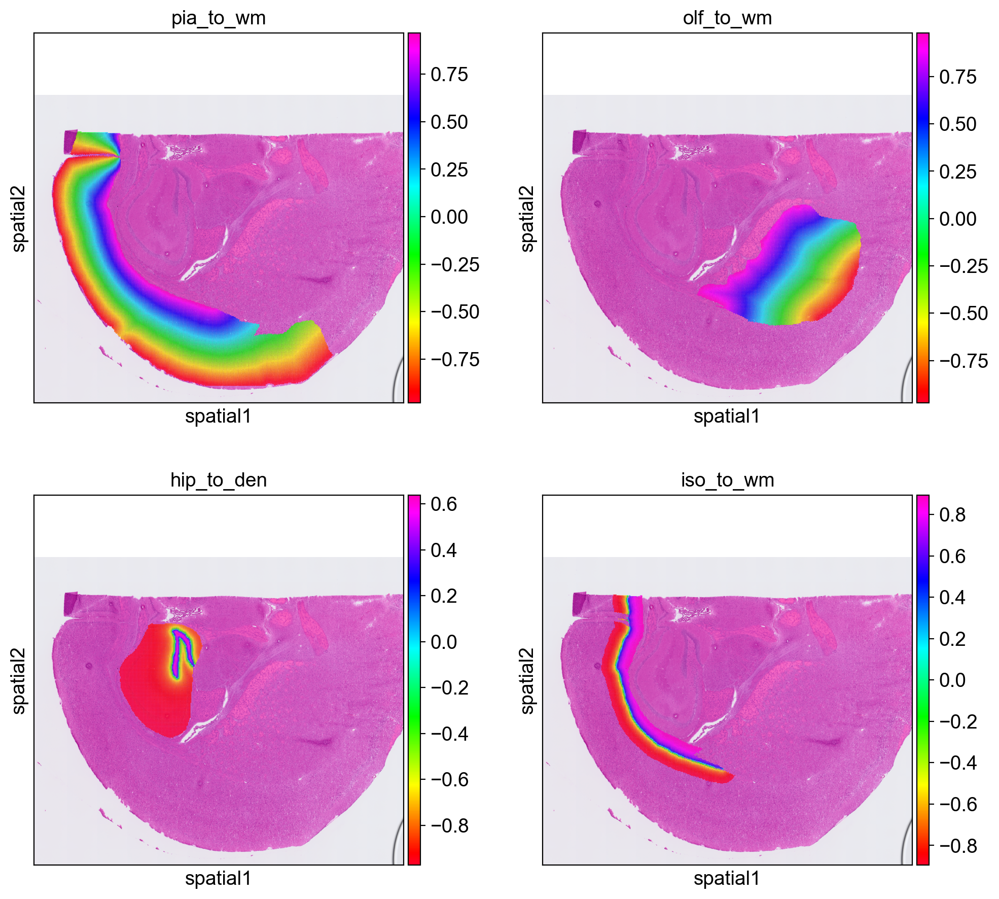

In [104]:
# plot the newly annotated visium AnnData
import scanpy as sc
sc.set_figure_params(figsize=[5,5],dpi=100)
sc.pl.spatial(adata,color=['pia_to_wm','olf_to_wm','hip_to_den','iso_to_wm'],cmap='gist_rainbow',ncols=2)

863765733.py (6): Use `squidpy.pl.spatial_scatter` instead.


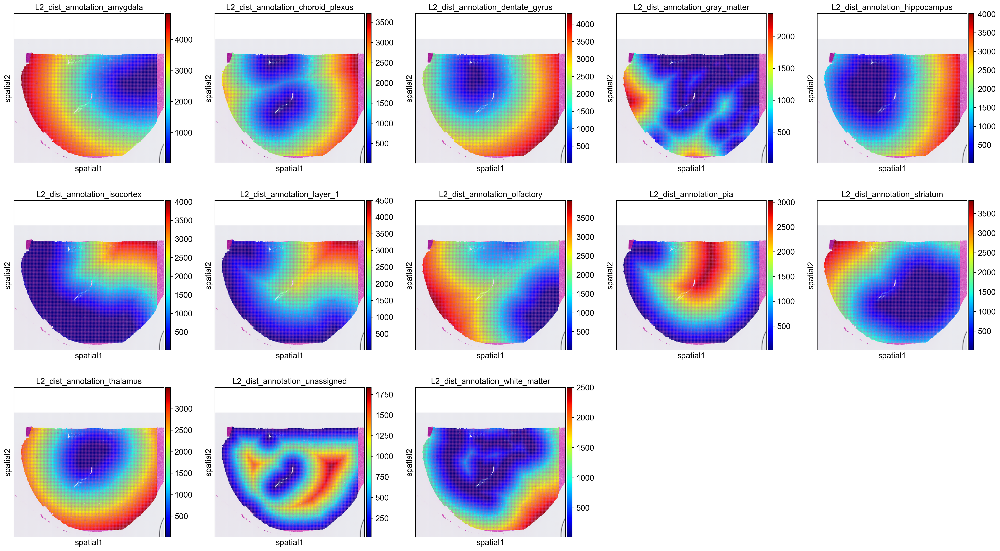

In [107]:

# Get all obs columns that contain "L2_dist"
l2_dist_cols = [col for col in adata.obs.columns if 'L2_dist' in col]

# Plot them using scanpy
sc.set_figure_params(figsize=[5, 5], dpi=100)
sc.pl.spatial(adata, color=l2_dist_cols, cmap='jet', ncols=5)


2677223834.py (1): Use `squidpy.pl.spatial_scatter` instead.


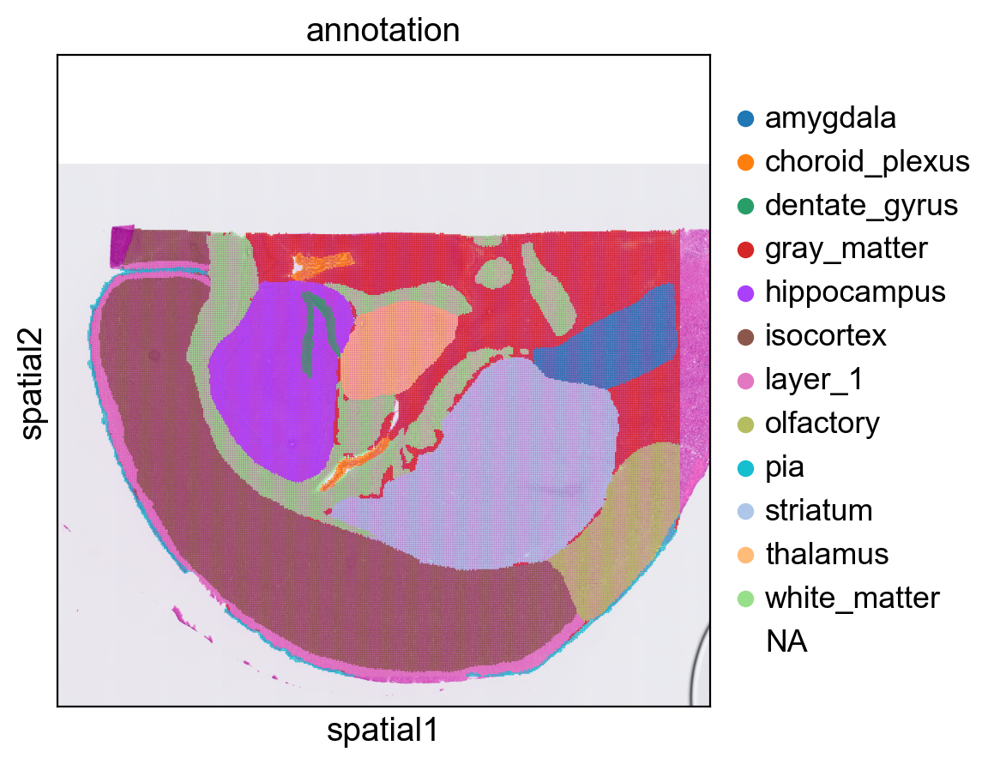

In [106]:
sc.pl.spatial(adata,color=['annotation'],ncols=3) # andrian march the colors!

In [108]:
# downstream analysis 
sc.pp.filter_cells(adata,min_counts=100)
sc.pp.normalize_total(adata)
sc.pp.log1p(adata)

anndata.py (1758): Variable names are not unique. To make them unique, call `.var_names_make_unique`.


In [109]:
adata.var_names_make_unique()

In [112]:
sc.pp.highly_variable_genes(adata,n_top_genes=5000)
adata = adata[:, adata.var["highly_variable"]].copy()
sc.pp.scale(adata, max_value=10)
sc.pp.pca(adata, use_highly_variable=True)
sc.pp.neighbors(adata)
sc.tl.umap(adata)



__init__.py (439): Argument `use_highly_variable` is deprecated, consider using the mask argument. Use_highly_variable=True can be called through mask_var="highly_variable". Use_highly_variable=False can be called through mask_var=None


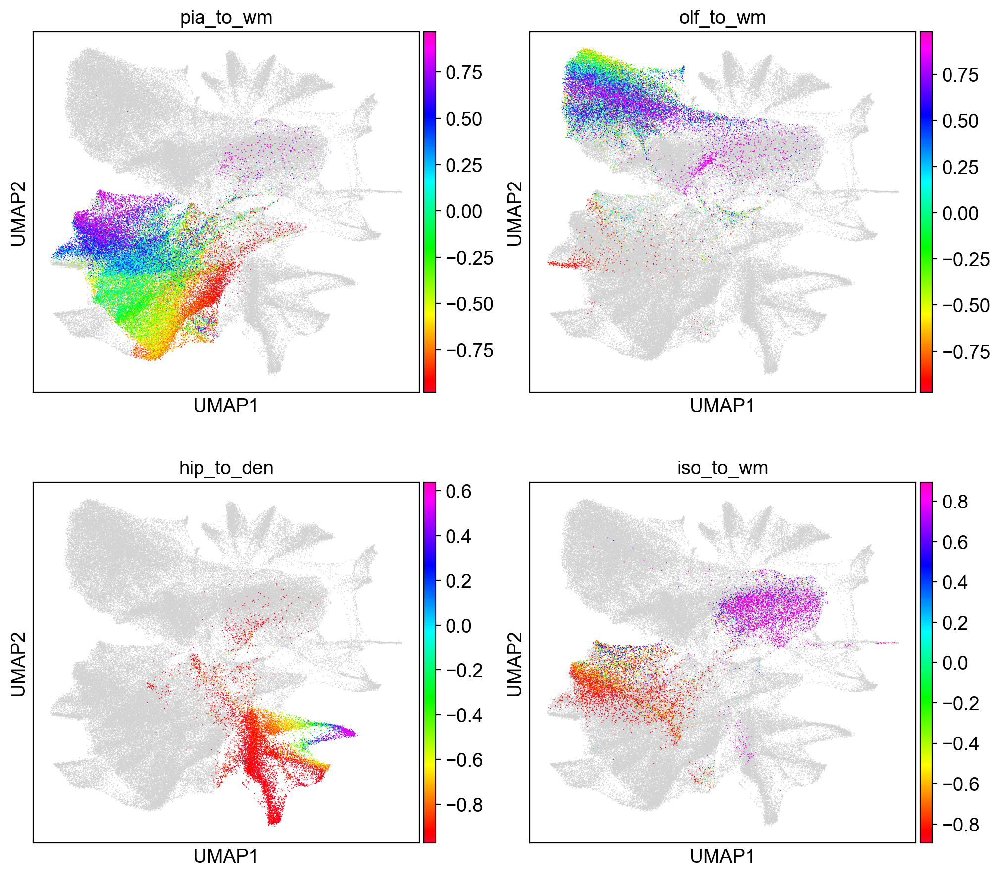

In [114]:
sc.pl.umap(adata,color=['pia_to_wm','olf_to_wm','hip_to_den','iso_to_wm'],cmap='gist_rainbow',ncols=2,s=2)

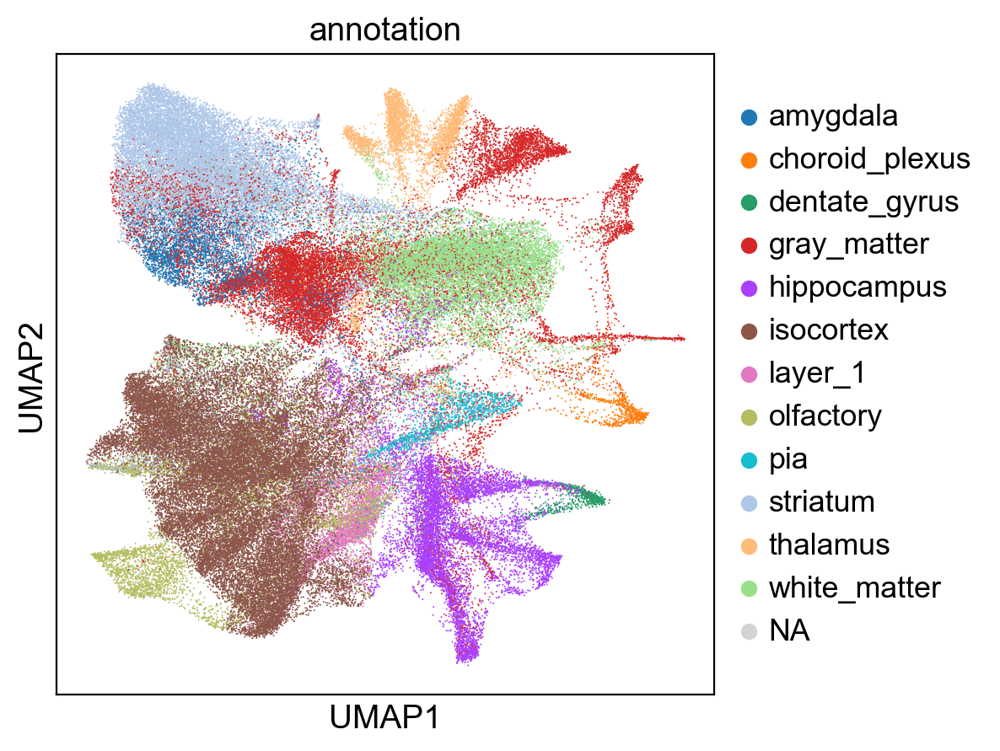

In [115]:
sc.pl.umap(adata,color=['annotation'],ncols=2,s=2)